# Instalacja detectronu 2

In [ ]:
!pip install -U torch torchvision
!pip install git+https://github.com/facebookresearch/fvcore.git
import torch, torchvision
torch.__version__

  Cloning https://github.com/facebookresearch/fvcore.git to /tmp/pip-req-build-smmdzik_
  Running command git clone -q https://github.com/facebookresearch/fvcore.git /tmp/pip-req-build-smmdzik_
     |████████████████████████████████| 636 kB 5.3 MB/s 
  Created wheel for fvcore: filename=fvcore-0.1.5-py3-none-any.whl size=64553 sha256=84cc71b39c51a674906d5a2629ab18cd92ef527d8ffb4220388ef27d4b7d7a97
  Stored in directory: /tmp/pip-ephem-wheel-cache-zzox_bcw/wheels/24/1d/09/8167de727fe5b74f832b6fcb5d9069d8f03ca29f337bfe484d
Successfully built fvcore
  Attempting uninstall: pyyaml
    Found existing installation: PyYAML 3.13
    Uninstalling PyYAML-3.13:
      Successfully uninstalled PyYAML-3.13


'1.9.0+cu102'

In [ ]:
!git clone https://github.com/facebookresearch/detectron2 detectron2_repo
!pip install -e detectron2_repo

Cloning into 'detectron2_repo'...
remote: Enumerating objects: 13028, done.
remote: Counting objects: 100% (529/529), done.
remote: Compressing objects: 100% (257/257), done.
remote: Total 13028 (delta 306), reused 437 (delta 268), pack-reused 12499
Receiving objects: 100% (13028/13028), 5.59 MiB | 17.08 MiB/s, done.
Resolving deltas: 100% (9262/9262), done.
Obtaining file:///content/detectron2_repo
     |████████████████████████████████| 74 kB 2.2 MB/s 
     |████████████████████████████████| 145 kB 11.2 MB/s 
     |████████████████████████████████| 130 kB 45.1 MB/s 
     |████████████████████████████████| 743 kB 38.0 MB/s 
     |████████████████████████████████| 745 kB 36.5 MB/s 
     |████████████████████████████████| 112 kB 45.3 MB/s 
  Created wheel for antlr4-python3-runtime: filename=antlr4_python3_runtime-4.8-py3-none-any.whl size=141230 sha256=c4e36f8e675509d3d90bb5a9e88f3ff3ec810e4f2cce2b7a0a6fcac8d98bff0b
  Stored in directory: /root/.cache/pip/wheels/ca/33/b7/336836125fc9bb

Przed uruchomieniem komórek poniżej należy uruchomić ponownie środowisko wykonawcze

## Import bibliotek

In [ ]:
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

import matplotlib.pyplot as plt
import numpy as np
import cv2
from google.colab.patches import cv2_imshow
import random
import tqdm
import os


from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog
from detectron2.engine import DefaultTrainer
from detectron2 import model_zoo
from detectron2.data.datasets import register_coco_instances


## Ściagnięcie oraz rejestracja własnych datasetów w formacie COCO



In [ ]:
!gdown --id 1c5vXk-WL75t8xHXB9Wj8nZoFzAg7YCBl
!gdown --id 1ajodZ943qLLd0rR31g4pD99tkQNMatVF
!unzip volleyball_difficult.zip
!unzip volleyball_easy.zip

Downloading...
From: https://drive.google.com/uc?id=1c5vXk-WL75t8xHXB9Wj8nZoFzAg7YCBl
To: /content/volleyball_easy.zip
39.3MB [00:00, 94.5MB/s]
Downloading...
From: https://drive.google.com/uc?id=1ajodZ943qLLd0rR31g4pD99tkQNMatVF
To: /content/volleyball_difficult.zip
98.3MB [00:02, 41.2MB/s]
Archive:  volleyball_difficult.zip
   creating: volleyball_difficult/
   creating: volleyball_difficult/test/
  inflating: volleyball_difficult/test/VID_20200914_223523-003_jpg.rf.7be0c2e2d1ab6a8357324ed8da6b3023.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-009.rf.704d547ecf12e7c7d32143728be702cc.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-025.rf.1064ee05f5dfc5d52f89011fc3a764a1.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-025_jpg.rf.526c554290e87bf6a6c81ede03206b63.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-027.rf.ef9fcf26c60675ba23f7721dcbc1757e.jpg  
  inflating: volleyball_difficult/test/VID_20200914_223523-028.r

In [ ]:
register_coco_instances("volleyball_easy_train", {},
                        "/content/volleyball_easy/train/_annotations.coco.json",
                        "/content/volleyball_easy/train")
register_coco_instances("volleyball_easy_test", {},
                        "/content/volleyball_easy/test/_annotations.coco.json",
                        "/content/volleyball_easy/test")
register_coco_instances("volleyball_difficult_train", {},
                        "/content/volleyball_difficult/train/_annotations.coco.json",
                        "/content/volleyball_difficult/train")
register_coco_instances("volleyball_difficult_test", {},
                        "/content/volleyball_difficult/test/_annotations.coco.json",
                        "/content/volleyball_difficult/test")

In [ ]:
volleyball_easy_train_metadata = MetadataCatalog.get("volleyball_easy_train")
dataset_dicts = DatasetCatalog.get("volleyball_easy_train")
volleyball_easy_test_metadata = MetadataCatalog.get("volleyball_easy_test")
dataset_dicts2 = DatasetCatalog.get("volleyball_easy_test")
volleyball_difficult_train_metadata = MetadataCatalog.get("volleyball_difficult_train")
dataset_dicts3 = DatasetCatalog.get("volleyball_difficult_train")
volleyball_difficult_test_metadata = MetadataCatalog.get("volleyball_difficult_test")
dataset_dicts4 = DatasetCatalog.get("volleyball_difficult_test")

print(volleyball_easy_train_metadata)
print(volleyball_easy_test_metadata)
print(volleyball_difficult_train_metadata)
print(volleyball_difficult_test_metadata)

[09/18 19:56:37 d2.data.datasets.coco]: Loaded 1200 images in COCO format from /content/volleyball_easy/train/_annotations.coco.json
[09/18 19:56:37 d2.data.datasets.coco]: Loaded 100 images in COCO format from /content/volleyball_easy/test/_annotations.coco.json
[09/18 19:56:37 d2.data.datasets.coco]: Loaded 914 images in COCO format from /content/volleyball_difficult/train/_annotations.coco.json
[09/18 19:56:37 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/volleyball_difficult/test/_annotations.coco.json
Metadata(evaluator_type='coco', image_root='/content/volleyball_easy/train', json_file='/content/volleyball_easy/train/_annotations.coco.json', name='volleyball_easy_train', thing_classes=['Ball'], thing_dataset_id_to_contiguous_id={1: 0})
Metadata(evaluator_type='coco', image_root='/content/volleyball_easy/test', json_file='/content/volleyball_easy/test/_annotations.coco.json', name='volleyball_easy_test', thing_classes=['Ball'], thing_dataset_id_to_contiguou

Przykładowe zdjęcia z "łatwego" zestawu


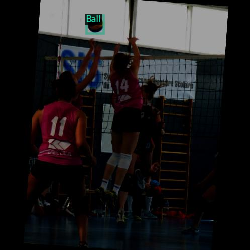

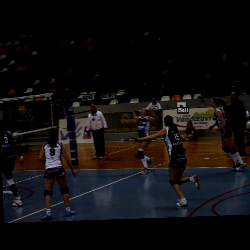

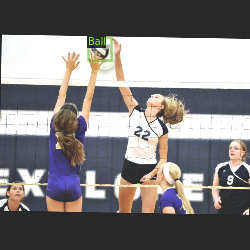

Przykładowe zdjęcia z "trudnego" zestawu


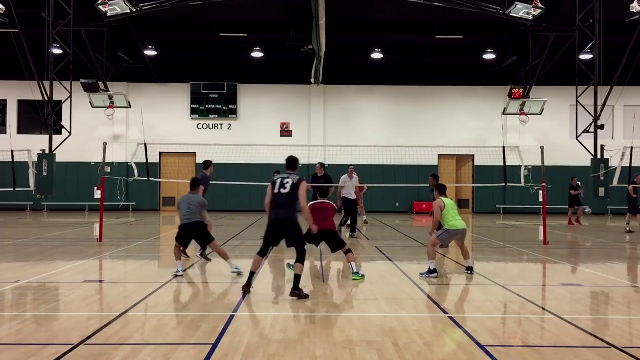

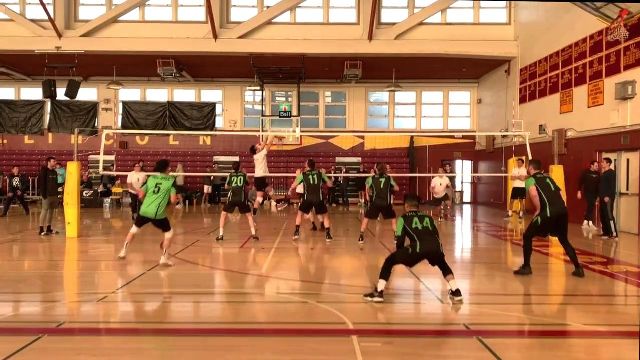

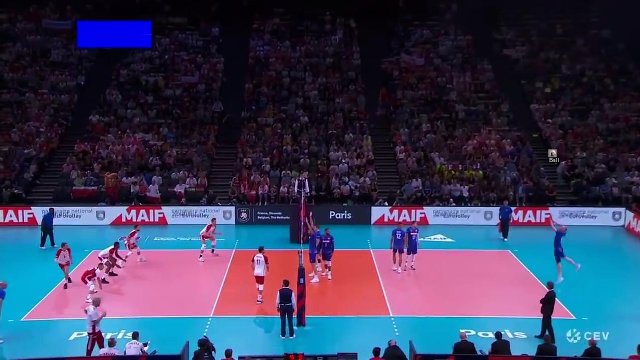

In [ ]:
print('Przykładowe zdjęcia z "łatwego" zestawu')
for d in random.sample(dataset_dicts2, 1):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=volleyball_difficult_test_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])
print('Przykładowe zdjęcia z "trudnego" zestawu')
for d in random.sample(dataset_dicts4, 1):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=volleyball_difficult_test_metadata, scale=0.5)
    vis = visualizer.draw_dataset_dict(d)
    cv2_imshow(vis.get_image()[:, :, ::-1])

#Trenowanie modelu na "prostym" datasecie

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("volleyball_easy_train",)
cfg.DATASETS.TEST = ('volleyball_easy_test',)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.005
cfg.SOLVER.MAX_ITER = 4000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # ball class

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)

[09/18 20:14:56 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

Skip loading parameter 'roi_heads.box_predictor.cls_score.weight' to the model due to incompatible shapes: (81, 1024) in the checkpoint but (2, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.cls_score.bias' to the model due to incompatible shapes: (81,) in the checkpoint but (2,) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.weight' to the model due to incompatible shapes: (320, 1024) in the checkpoint but (4, 1024) in the model! You might want to double check if this is expected.
Skip loading parameter 'roi_heads.box_predictor.bbox_pred.bias' to the model due to incompatible shapes: (320,) in the checkpoint but (4,) in the model! You might want to double check if this is expected.
Some model parameters or buffers are not found in the checkpoint:
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, we

In [ ]:
trainer.train()

[09/18 20:14:59 d2.engine.train_loop]: Starting training from iteration 0
[09/18 20:15:20 d2.utils.events]:  eta: 1:10:06  iter: 19  total_loss: 0.6635  loss_cls: 0.5657  loss_box_reg: 0.05825  loss_rpn_cls: 0.04463  loss_rpn_loc: 0.005345  time: 1.0154  data_time: 0.0206  lr: 9.9905e-05  max_mem: 3067M
[09/18 20:15:40 d2.utils.events]:  eta: 1:07:14  iter: 39  total_loss: 0.2731  loss_cls: 0.1435  loss_box_reg: 0.06838  loss_rpn_cls: 0.04174  loss_rpn_loc: 0.006853  time: 0.9959  data_time: 0.0093  lr: 0.0001998  max_mem: 3067M
[09/18 20:16:00 d2.utils.events]:  eta: 1:06:35  iter: 59  total_loss: 0.2194  loss_cls: 0.09076  loss_box_reg: 0.07788  loss_rpn_cls: 0.03949  loss_rpn_loc: 0.006373  time: 1.0005  data_time: 0.0116  lr: 0.0002997  max_mem: 3067M
[09/18 20:16:20 d2.utils.events]:  eta: 1:06:34  iter: 79  total_loss: 0.2129  loss_cls: 0.08273  loss_box_reg: 0.09761  loss_rpn_cls: 0.02405  loss_rpn_loc: 0.004606  time: 1.0037  data_time: 0.0112  lr: 0.00039961  max_mem: 3067M
[0

##Tworzenie predyktora i wizualizacja rezultatów


In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set the testing threshold for this model
cfg.DATASETS.TEST = ("volleyball_easy_test", )
predictor = DefaultPredictor(cfg)

{'instances': Instances(num_instances=4, image_height=500, image_width=500, fields=[pred_boxes: Boxes(tensor([[110.8548,  99.0808, 164.5029, 149.9931],
        [ 10.0016,  59.2261,  35.1248,  76.9859],
        [162.3705,  73.5575, 186.3165,  90.7789],
        [169.8015, 175.5549, 201.5055, 201.8078]], device='cuda:0')), scores: tensor([0.9979, 0.9035, 0.9026, 0.6442], device='cuda:0'), pred_classes: tensor([0, 0, 0, 0], device='cuda:0')])}


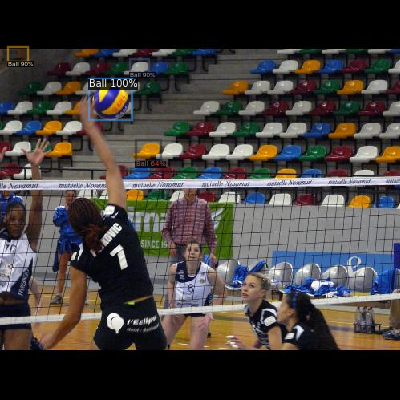

{'instances': Instances(num_instances=2, image_height=500, image_width=500, fields=[pred_boxes: Boxes(tensor([[183.8753, 130.4416, 247.4968, 188.9716],
        [257.6892,  44.7844, 310.9165,  98.2500]], device='cuda:0')), scores: tensor([0.9980, 0.5071], device='cuda:0'), pred_classes: tensor([0, 0], device='cuda:0')])}


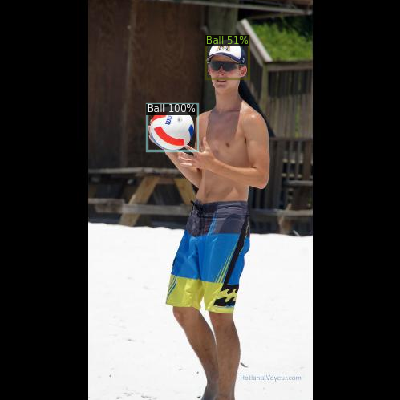

{'instances': Instances(num_instances=2, image_height=500, image_width=500, fields=[pred_boxes: Boxes(tensor([[194.8280, 103.0996, 227.0341, 136.5948],
        [205.0452, 346.7944, 221.0157, 362.0058]], device='cuda:0')), scores: tensor([0.9953, 0.9355], device='cuda:0'), pred_classes: tensor([0, 0], device='cuda:0')])}


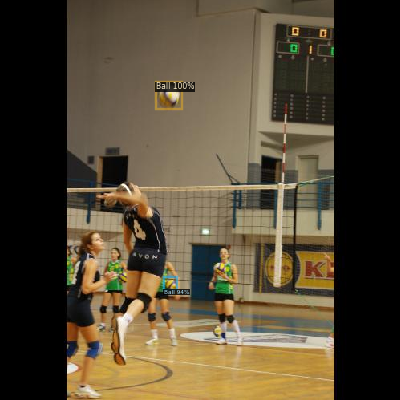

In [ ]:
for d in random.sample(dataset_dicts2, 3):
  im = cv2.imread(d["file_name"])    
  outputs = predictor(im)
  print(outputs)
  v = Visualizer(im[:, :, ::-1],
                  metadata=volleyball_easy_train_metadata, 
                  scale=0.8,
  )
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(v.get_image()[:, :, ::-1])

## Czas inferencji

In [ ]:
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

Average(sec):0.28,fps:3.61


##Wyniki predyktora na "prostym" datasecie

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("volleyball_easy_test", ("bbox",), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "volleyball_easy_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[09/18 21:19:50 d2.data.datasets.coco]: Loaded 100 images in COCO format from /content/volleyball_easy/test/_annotations.coco.json
[09/18 21:19:50 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/18 21:19:50 d2.data.common]: Serializing 100 elements to byte tensors and concatenating them all ...
[09/18 21:19:50 d2.data.common]: Serialized dataset takes 0.03 MiB
[09/18 21:19:50 d2.evaluation.evaluator]: Start inference on 100 batches
[09/18 21:19:53 d2.evaluation.evaluator]: Inference done 11/100. Dataloading: 0.0015 s/iter. Inference: 0.2647 s/iter. Eval: 0.0003 s/iter. Total: 0.2665 s/iter. ETA=0:00:23
[09/18 21:19:58 d2.evaluation.evaluator]: Inference done 30/100. Dataloading: 0.0023 s/iter. Inference: 0.2639 s/iter. Eval: 0.0003 s/iter. Total: 0.2667 s/iter. ETA=0:00:18
[09/18 21:20:03 d2.evaluation.evaluator]: Inference done 49/100. Dataloading: 0.0021 s/iter. Infe

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

##Sprawdzenie skuteczności detektora na realistycznych przykładach z "trudnego" datasetu

In [ ]:
evaluator = COCOEvaluator("volleyball_difficult_test", ("bbox",), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "volleyball_difficult_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[09/18 21:20:21 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/volleyball_difficult/test/_annotations.coco.json
[09/18 21:20:21 d2.data.build]: Distribution of instances among all 1 categories:
|  category  | #instances   |
|:----------:|:-------------|
|    Ball    | 43           |
|            |              |
[09/18 21:20:21 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/18 21:20:21 d2.data.common]: Serializing 51 elements to byte tensors and concatenating them all ...
[09/18 21:20:21 d2.data.common]: Serialized dataset takes 0.01 MiB
[09/18 21:20:21 d2.evaluation.evaluator]: Start inference on 51 batches
[09/18 21:20:26 d2.evaluation.evaluator]: Inference done 11/51. Dataloading: 0.0017 s/iter. Inference: 0.3894 s/iter. Eval: 0.0003 s/iter. Total: 0.3913 s/iter. ETA=0:00:15
[09/18 21:20:31 d2.evaluation.evaluator]: Inference done 24/51. Data

**Trenowanie na obrazkach z openimages nie wystarczy do wytrenowania sieci na nasze potrzeby**

In [ ]:
os.rename('/content/output/model_final.pth','/content/output/model_final_easy.pth')

## Trenowanie modelu na "trudnym" datasecie

In [ ]:
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-Detection/faster_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("volleyball_difficult_train",)
cfg.DATASETS.TEST = ('volleyball_difficult_test',)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final_easy.pth")
cfg.SOLVER.IMS_PER_BATCH = 2
cfg.SOLVER.BASE_LR = 0.003
cfg.SOLVER.MAX_ITER = 4000
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 1 # ball class



os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)


[09/18 21:29:12 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

In [ ]:
trainer.train()

[09/18 21:29:15 d2.engine.train_loop]: Starting training from iteration 0
[09/18 21:29:46 d2.utils.events]:  eta: 1:39:57  iter: 19  total_loss: 0.2128  loss_cls: 0.06771  loss_box_reg: 0.06138  loss_rpn_cls: 0.0219  loss_rpn_loc: 0.02683  time: 1.4912  data_time: 0.0233  lr: 5.9943e-05  max_mem: 4035M
[09/18 21:30:16 d2.utils.events]:  eta: 1:43:25  iter: 39  total_loss: 0.1901  loss_cls: 0.07553  loss_box_reg: 0.05441  loss_rpn_cls: 0.02419  loss_rpn_loc: 0.01708  time: 1.5124  data_time: 0.0106  lr: 0.00011988  max_mem: 4035M
[09/18 21:30:47 d2.utils.events]:  eta: 1:43:05  iter: 59  total_loss: 0.1702  loss_cls: 0.05864  loss_box_reg: 0.05969  loss_rpn_cls: 0.01404  loss_rpn_loc: 0.0166  time: 1.5162  data_time: 0.0117  lr: 0.00017982  max_mem: 4035M
[09/18 21:31:17 d2.utils.events]:  eta: 1:42:30  iter: 79  total_loss: 0.1388  loss_cls: 0.04702  loss_box_reg: 0.04833  loss_rpn_cls: 0.02485  loss_rpn_loc: 0.01909  time: 1.5157  data_time: 0.0086  lr: 0.00023976  max_mem: 4035M
[09/

In [ ]:
os.rename('/content/output/model_final.pth','/content/output/model_final_difficult_easy.pth')

In [ ]:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final_difficult_easy.pth")
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5  # set the testing threshold for this model
cfg.DATASETS.TEST = ("volleyball_difficult_test", )
predictor = DefaultPredictor(cfg)

In [ ]:
evaluator = COCOEvaluator("volleyball_difficult_test", ("bbox",), False, output_dir="./output/")
val_loader = build_detection_test_loader(cfg, "volleyball_difficult_test")
print(inference_on_dataset(trainer.model, val_loader, evaluator))

[09/18 23:10:08 d2.data.datasets.coco]: Loaded 51 images in COCO format from /content/volleyball_difficult/test/_annotations.coco.json
[09/18 23:10:08 d2.data.dataset_mapper]: [DatasetMapper] Augmentations used in inference: [ResizeShortestEdge(short_edge_length=(800, 800), max_size=1333, sample_style='choice')]
[09/18 23:10:08 d2.data.common]: Serializing 51 elements to byte tensors and concatenating them all ...
[09/18 23:10:08 d2.data.common]: Serialized dataset takes 0.01 MiB
[09/18 23:10:08 d2.evaluation.evaluator]: Start inference on 51 batches
[09/18 23:10:13 d2.evaluation.evaluator]: Inference done 11/51. Dataloading: 0.0016 s/iter. Inference: 0.4001 s/iter. Eval: 0.0003 s/iter. Total: 0.4019 s/iter. ETA=0:00:16
[09/18 23:10:18 d2.evaluation.evaluator]: Inference done 24/51. Dataloading: 0.0025 s/iter. Inference: 0.3979 s/iter. Eval: 0.0003 s/iter. Total: 0.4010 s/iter. ETA=0:00:10
[09/18 23:10:23 d2.evaluation.evaluator]: Inference done 37/51. Dataloading: 0.0025 s/iter. Infer

**Stwierdzono zdecydowaną poprawę rezultatów**

## Wizualizacja

{'instances': Instances(num_instances=1, image_height=720, image_width=1280, fields=[pred_boxes: Boxes(tensor([[675.1174, 311.3621, 720.9526, 356.2236]], device='cuda:0')), scores: tensor([0.9982], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


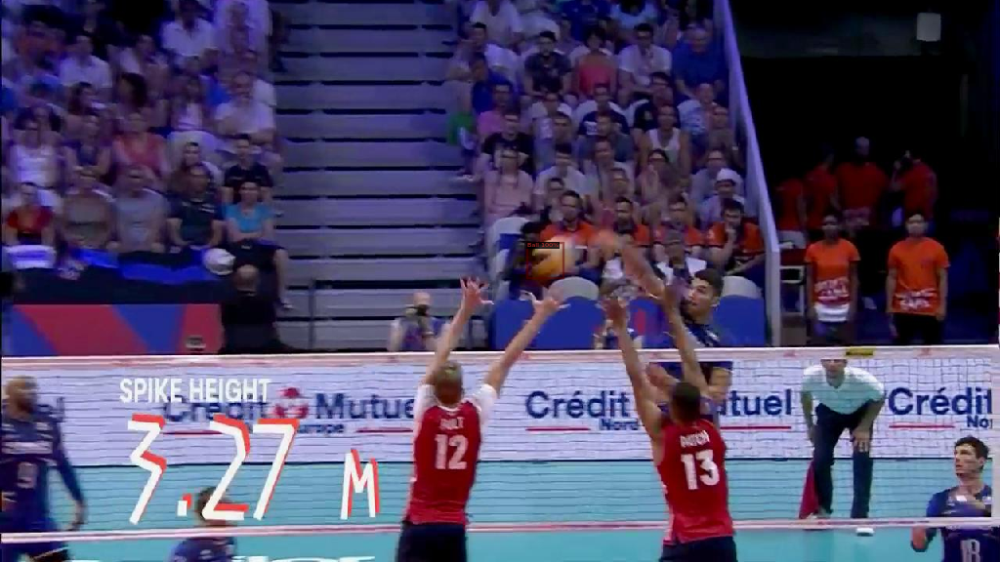

{'instances': Instances(num_instances=1, image_height=720, image_width=1280, fields=[pred_boxes: Boxes(tensor([[1091.4471,  357.6611, 1126.9531,  393.3612]], device='cuda:0')), scores: tensor([0.9991], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


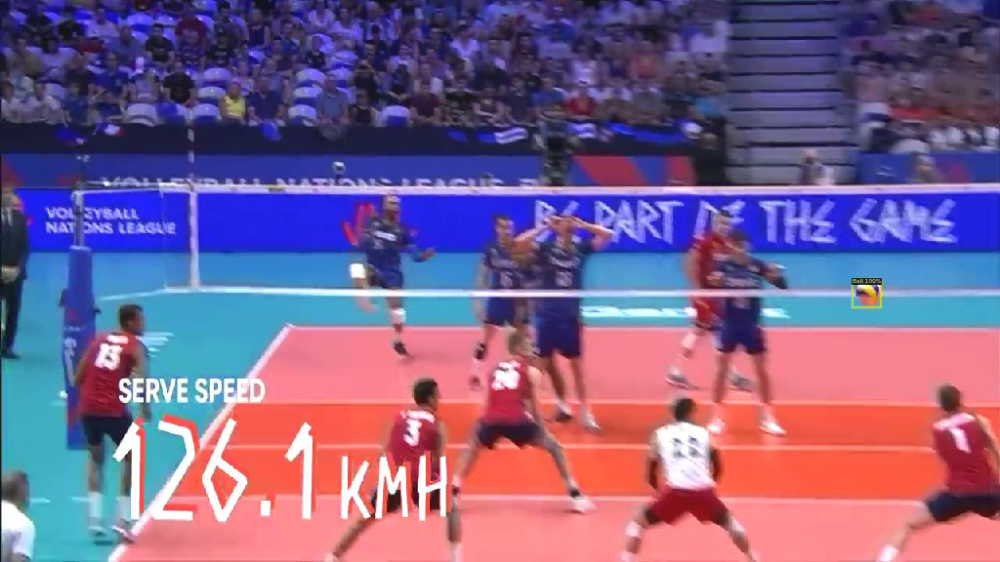

{'instances': Instances(num_instances=1, image_height=720, image_width=1280, fields=[pred_boxes: Boxes(tensor([[814.8945,  12.2998, 830.4503,  28.3797]], device='cuda:0')), scores: tensor([0.9966], device='cuda:0'), pred_classes: tensor([0], device='cuda:0')])}


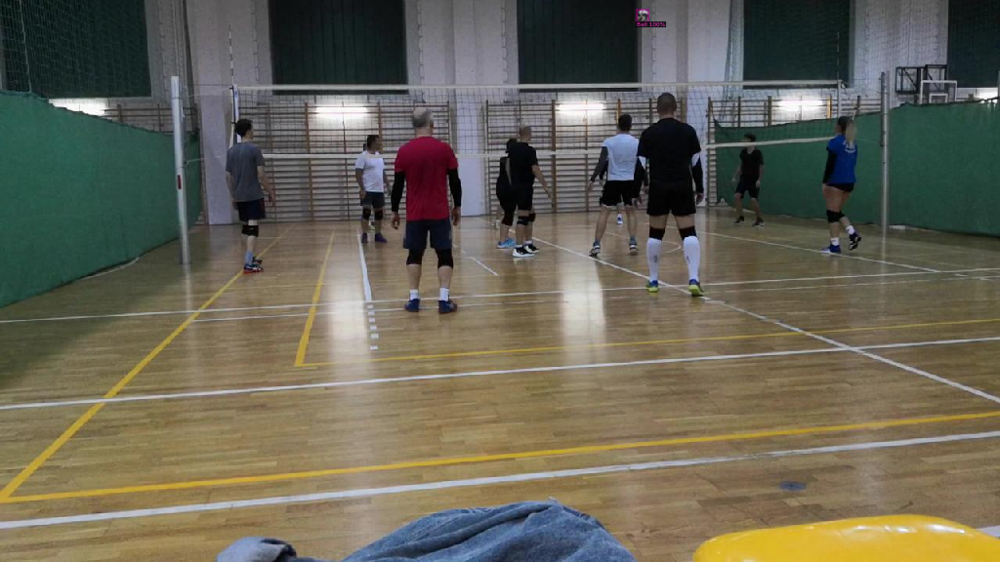

In [ ]:
for d in random.sample(dataset_dicts3, 3):
  im = cv2.imread(d["file_name"])    
  outputs = predictor(im)
  print(outputs)
  v = Visualizer(im[:, :, ::-1],
                  metadata=volleyball_easy_train_metadata, 
                  scale=0.8,
  )
  v = v.draw_instance_predictions(outputs["instances"].to("cpu"))
  cv2_imshow(v.get_image()[:, :, ::-1])

Wyniki inferencji

In [ ]:
import time
times = []
for i in range(20):
    start_time = time.time()
    outputs = predictor(im)
    delta = time.time() - start_time
    times.append(delta)
mean_delta = np.array(times).mean()
fps = 1 / mean_delta
print("Average(sec):{:.2f},fps:{:.2f}".format(mean_delta, fps))

In [ ]:
# Look at training curves in tensorboard:
%reload_ext tensorboard
%tensorboard --logdir output

Reusing TensorBoard on port 6006 (pid 1466), started 1:50:18 ago. (Use '!kill 1466' to kill it.)

<IPython.core.display.Javascript object>